In [ ]:
from io import StringIO
import os

import boto3
import pandas as pd
pd.set_option("display.max_columns", 55)

In [ ]:
aws_access_key_id = os.getenv("AWS_ACCESS_KEY")
aws_secret_key = os.getenv("AWS_SECRET_KEY")

In [ ]:
def read_csv_from_s3(bucket: str, 
                     path: str, 
                     filename: str) -> pd.DataFrame:
    """
    Downloads a csv file from an S3 bucket.

    Parameters
    ----------
        bucket (str): The bucket where the files are.
        path (str): The folders to the file.
        filename (str): Name of the file.

    Returns
    -------
        DataFrame: A DataFrame of the downloaded file.
    """
    s3 = boto3.client("s3", 
                      aws_access_key_id = aws_access_key_id, 
                      aws_secret_access_key = aws_secret_key)
    full_path = f"{path}{filename}"
    obj = s3.get_object(Bucket = bucket, 
                        Key = full_path)
    output_df = pd.read_csv(obj["Body"])

    return output_df

In [ ]:
s3 = boto3.client("s3",
                  aws_access_key_id = aws_access_key_id,
                  aws_secret_access_key = aws_secret_key)

bucket = "egle.final-project-bucket"

community_areas_path = "transformed_data/community_areas/"
company_path = "transformed_data/company/"
date_path = "transformed_data/date/"
payment_type_path = "transformed_data/payment_type/"
taxi_trips_path = "transformed_data/taxi_trips/"
weather_path = "transformed_data/weather/"


community_areas = read_csv_from_s3(bucket, 
                                   community_areas_path, 
                                   "Chicago_community_areas_master.csv")

company = read_csv_from_s3(bucket, 
                           company_path, 
                           "company_master.csv")

date = read_csv_from_s3(bucket, 
                        date_path, 
                        "date_dim_table.csv")

payment_type = read_csv_from_s3(bucket,
                                payment_type_path,
                                "payment_type_master.csv")

In [ ]:
community_areas

In [ ]:
company

In [ ]:
date

In [ ]:
payment_type

In [ ]:
trips_list = []

weather_list = []

In [ ]:
for file in s3.list_objects(Bucket=bucket, 
                            Prefix=taxi_trips_path)["Contents"]:
    taxi_trip_key = file["Key"]
    if taxi_trip_key.split("/")[-1].strip() != "":
        if taxi_trip_key.split(".")[-1] == "csv":
            filename = taxi_trip_key.split("/")[-1]
            trip = read_csv_from_s3(bucket, 
                                    taxi_trips_path, 
                                    filename)
            trips_list.append(trip)
            print(f"{filename} has been added to the list.")

trips = pd.concat(trips_list,
                  ignore_index=True)


response = s3.list_objects_v2(Bucket=bucket, 
                              Prefix=weather_path)
if 'Contents' in response:
    for file in response["Contents"]:
        weather_key = file["Key"]
        if weather_key.split("/")[-1].strip() != "":
            if weather_key.split(".")[-1] == "csv":
                filename = weather_key.split("/")[-1]
                weather = read_csv_from_s3(bucket,
                                           weather_path,
                                           filename)
                weather_list.append(weather)
                print(f"{filename} has been added to the lsit.")

weather = pd.concat(weather_list,
                    ignore_index=True)

In [ ]:
print(trips.info())
print(trips.shape)
trips

In [ ]:
print(weather.info())
print(weather.shape)
weather

In [ ]:
trips_full = pd.merge(trips, weather, 
                      left_on = "datetime_for_weather",
                      right_on = "datetime",
                      how = "inner")
trips_full = trips_full.drop(columns = ["datetime"])

print(trips_full. columns)
trips_full

In [ ]:
trips_full = pd.merge(trips_full, company, 
                      left_on = "company_id",
                      right_on = "company_id",
                      how = "inner")
trips_full = trips_full.drop(columns = ["company_id"])


trips_full = pd.merge(trips_full, payment_type, 
                      left_on = "payment_type_id", 
                      right_on = "payment_type_id", 
                      how = "inner")
trips_full = trips_full.drop(columns = ["payment_type_id"])


trips_full = pd.merge(trips_full, community_areas, 
                      left_on = "pickup_community_area_id", 
                      right_on = "area_code", 
                      how = "inner")
trips_full = trips_full.drop(columns = ["pickup_community_area_id",
                                        "area_code"])
trips_full.rename(columns = {"community_name": "pickup_community_area_name"},
                  inplace = True)


trips_full = pd.merge(trips_full, community_areas, 
                      left_on = "dropoff_community_area_id", 
                      right_on = "area_code", 
                      how = "inner")
trips_full = trips_full.drop(columns = ["dropoff_community_area_id",
                                        "area_code"])
trips_full.rename(columns = {"community_name": "dropoff_community_area_name"},
                  inplace = True)


print(trips_full. columns)
trips_full

In [ ]:
date["Date"] = pd.to_datetime(date["Date"])

trips_full["trip_start_timestamp"] = pd.to_datetime(trips_full["trip_start_timestamp"]).dt.floor("d")
trips_full["trip_start_date"] = trips_full["trip_start_timestamp"]

trips_full = pd.merge(trips_full, date, 
                      left_on="trip_start_date", 
                      right_on="Date", 
                      how="inner")

trips_full = trips_full.drop(columns=["Date"])

print(trips_full.columns)
print(trips_full.shape)
trips_full

In [ ]:
trips_full.to_csv("Chicago_taxi_dataset.csv",
                      index = False)

# Final step: Visualizations

In [ ]:
import matplotlib.pyplot as plt

import networkx as nx

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df = trips_full

In [10]:
mobile_payments = df[df["payment_type"] == "Mobile"]

pickup_area_counts = mobile_payments["pickup_community_area_name"].value_counts().head(15).reset_index()
pickup_area_counts.columns = ["pickup_community_area_name", "count"]

fig = px.bar(
    pickup_area_counts, 
    x = "pickup_community_area_name", 
    y = "count", 
    title = "Top 15 Pickup Community Areas with Mobile Payments",
    labels = {"pickup_community_area_name": "Community Area", 
              "count": "Number of Mobile Payments"},
    template = "plotly_white",
    color = "count",
    color_continuous_scale = px.colors.sequential.Blues)

fig.update_traces(
    texttemplate = "%{y}", 
    textposition = "outside")

fig.update_layout(
    xaxis = dict(categoryorder = "total descending"),
    yaxis_title = "Number of Mobile Payments",
    xaxis_title = "Community Area",
    title_font_size = 20,
    title_x = 0.5,
    uniformtext_minsize = 8, 
    uniformtext_mode = "hide",
    plot_bgcolor = "rgba(0, 0, 0, 0)",
    yaxis = dict(showgrid = False),)

fig.show()

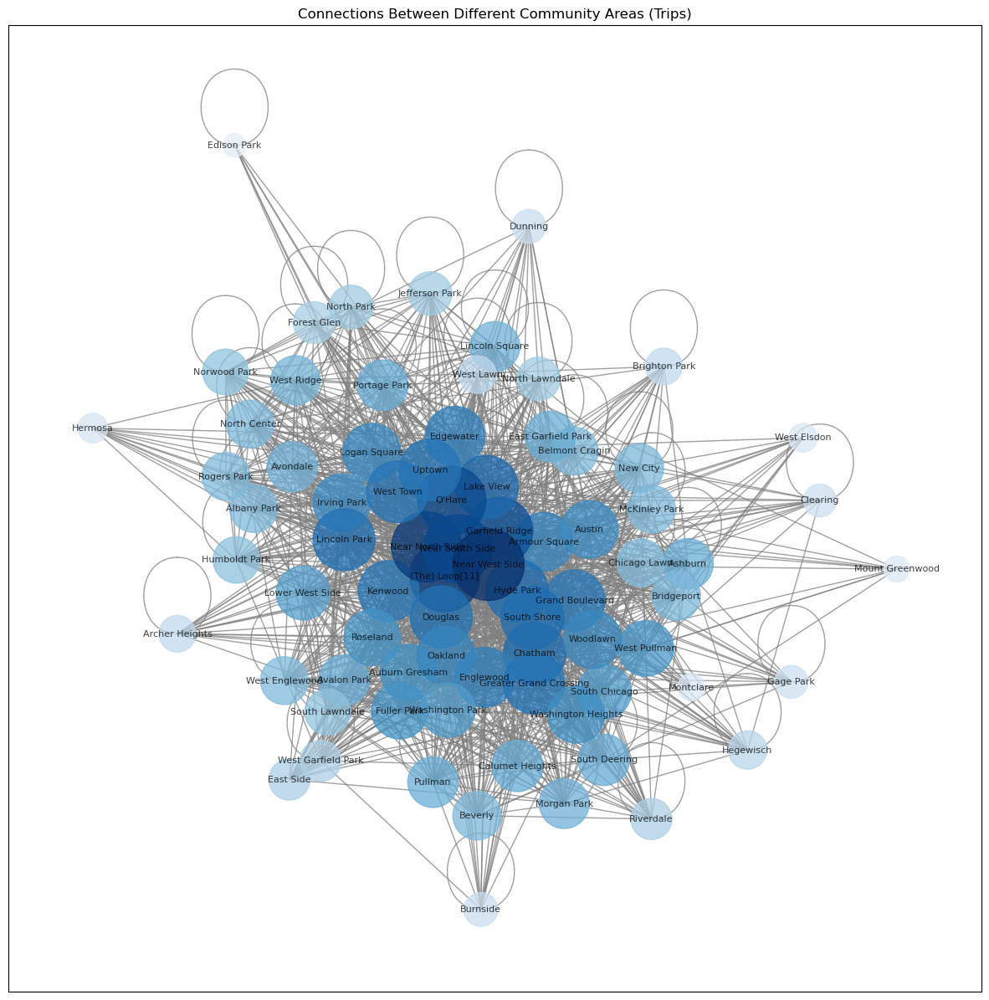

In [9]:
df_network = df[["pickup_community_area_name", 
                 "dropoff_community_area_name"]]

trip_counts = df_network.groupby(["pickup_community_area_name", 
                                  "dropoff_community_area_name"]).size().reset_index(name = "trip_count")

G = nx.from_pandas_edgelist(trip_counts, 
                            "pickup_community_area_name", 
                            "dropoff_community_area_name", 
                            ["trip_count"])

node_size = [G.degree(node) * 50 for node in G.nodes()]
color_map = [plt.cm.Blues(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes()]

plt.figure(figsize = (15, 15))
pos = nx.spring_layout(G, k = 0.2, seed = 42)
nx.draw_networkx(G, 
                 pos, 
                 node_size = node_size, 
                 node_color = color_map, 
                 edge_color = "gray", 
                 with_labels = True, 
                 font_size = 8, 
                 font_color = "black", 
                 alpha = 0.75)

plt.title("Connections Between Different Community Areas (Trips)")
plt.show()

In [ ]:
filtered_df = df[(df["trip_miles"] > 0) & (df["trip_miles"] <= 30) & (df["fare"] > 0) & (df["fare"] <= 300)]

fig = px.scatter(
    filtered_df, 
    x = "trip_miles", 
    y = "fare", 
    color = "payment_type",
    title = "The relationship between the distance traveled and the fare.",
    labels = {"trip_miles": "Distance traveled (miles)", 
              "fare": "Fare (dollars)"},
    color_discrete_sequence = px.colors.qualitative.Plotly,
    trendline = "ols",
    trendline_scope = "overall")

fig.show()

In [ ]:
company_revenue = df.groupby("company")["trip_total"].sum().reset_index()
smallest_companies = company_revenue.nsmallest(5, "trip_total")["company"]
largest_companies = company_revenue.nlargest(5, "trip_total")["company"]

df_smallest = df[df["company"].isin(smallest_companies)]
df_largest = df[df["company"].isin(largest_companies)]

fig = make_subplots(rows = 1, 
                    cols = 2, 
                    subplot_titles = ("5 Smallest Revenue Companies", 
                                      "5 Largest Revenue Companies"))

fig.add_trace(
    go.Violin(
        x = df_smallest["company"],
        y = df_smallest["trip_total"],
        name = "5 Smallest Revenue Companies",
        marker_color = "blue",
        points = "all",
        bandwidth = 0.5
    ),
    row = 1, col = 1
)

fig.add_trace(
    go.Violin(
        x = df_largest["company"],
        y = df_largest["trip_total"],
        name = "5 Largest Revenue Companies",
        marker_color = "red",
        points = "all",
        bandwidth = 0.5
    ),
    row = 1, col = 2
)

fig.update_layout(
    title_text = "Fare Distribution Across Different Taxi Companies",
    showlegend = False,
    xaxis_title = "Taxi Company",
    yaxis_title = "Fare (dollars)",
    xaxis2_title = "Taxi Company",
    yaxis2_title = "Fare (dollars)"
)

fig.update_yaxes(range = [0, 175], 
                 row = 1, 
                 col = 2)

fig.show()

In [7]:
df["datetime_for_weather"] = pd.to_datetime(df["datetime_for_weather"])
daily_tips = df.groupby(df["datetime_for_weather"].dt.date)["tips"].mean().reset_index()
daily_temperature = df.groupby(df["datetime_for_weather"].dt.date)["temperature"].mean().reset_index()
daily_wind_speed = df.groupby(df["datetime_for_weather"].dt.date)["wind_speed"].mean().reset_index()
daily_revenue = df.groupby(df["datetime_for_weather"].dt.date)["trip_total"].mean().reset_index()

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(x = daily_tips["datetime_for_weather"], 
               y = daily_tips["tips"], 
               name = "Average Tip", 
               line = dict(color = "blue")),
               secondary_y = False)
fig.add_trace(
    go.Scatter(x = daily_temperature["datetime_for_weather"], 
               y = daily_temperature["temperature"], 
               name = "Average Temperature", 
               line = dict(color = "orange")),
               secondary_y = True)

fig.add_trace(
    go.Scatter(x = daily_wind_speed["datetime_for_weather"], 
               y = daily_wind_speed["wind_speed"], 
               name = "Average Wind Speed", 
               line = dict(color = "green")),
               secondary_y = True)

fig.add_trace(
    go.Scatter(x = daily_revenue["datetime_for_weather"], 
               y = daily_revenue["trip_total"], 
               name = "Average Revenue", 
               line = dict(color = "purple", dash = "dash")),
               secondary_y = False)

fig.update_layout(
    title_text = "Trends in Tips, Temperature, Wind Speed, and Revenue Over Time",
    template = "plotly_white",
    legend = dict(x = 0.01, 
                  y = 0.99, 
                  bgcolor = "rgba(255,255,255,0)", 
                  bordercolor = "rgba(255,255,255,0)"))

fig.update_xaxes(title_text = "Date")
fig.update_yaxes(title_text = "Average Tip (dollars) / Average Revenue (dollars)", 
                 secondary_y = False)
fig.update_yaxes(title_text = "Average Temperature (°C) / Average Wind Speed (km/h)", 
                 secondary_y = True)

fig.show()